## *🔧 Setup*

In [2]:
!sudo apt-get install fluidsynth -y
!pip install midi2audio
!pip install music21
# !pip install pedalboard 

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  fluid-soundfont-gm libdouble-conversion3 libegl-mesa0 libegl1 libevdev2
  libfluidsynth2 libgbm1 libgudev-1.0-0 libinput-bin libinput10
  libinstpatch-1.0-2 libmtdev1 libpcre2-16-0 libqt5core5a libqt5dbus5
  libqt5gui5 libqt5network5 libqt5svg5 libqt5widgets5 libwacom-bin
  libwacom-common libwacom2 libwayland-server0 libxcb-icccm4 libxcb-image0
  libxcb-keysyms1 libxcb-render-util0 libxcb-util1 libxcb-xinerama0
  libxcb-xinput0 libxcb-xkb1 libxkbcommon-x11-0 qsynth qt5-gtk-platformtheme
  qttranslations5-l10n timgm6mb-soundfont
Suggested packages:
  fluid-soundfont-gs timidity qt5-image-formats-plugins qtwayland5 jackd
  musescore
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libdouble-conversion3 libegl-mesa0 libegl1
  libevdev2 libfluidsynth2 libgbm1 libgudev-1.0-0 libinput-bin libinput10
  libinstpatch

In [3]:
from music21 import corpus, converter, instrument, note, stream, chord, duration, tempo
from keras.layers import LSTM, Input, Dropout, Dense, Activation, Embedding, Concatenate, Reshape
from keras.layers import Flatten, RepeatVector, Permute, TimeDistributed
from tensorflow.keras.optimizers import RMSprop
from keras.layers import Multiply, Lambda, Softmax
import keras.backend as K 
from keras.models import Model
from IPython.display import Image, Audio
from midi2audio import FluidSynth
import matplotlib.pyplot as plt
import collections
import numpy as np
import random
import glob
import pickle
import keras
import time
import os

import warnings
warnings.filterwarnings('ignore')

random.seed(42)

In [4]:
music_files = [ele for ele in glob.glob("../input/classical-music-midi/*/*")]
print("A random song file example: ", random.sample(music_files, 1))
print("Number of songs are:", len(music_files))

A random song file example:  ['../input/classical-music-midi/haydn/haydn_33_2.mid']
Number of songs are: 295


## 🧼🧴🧽✨ *Processing*

In [5]:
def round_chord_durations(number):
    if(number>1.25):
        return 2
    if(number>.30):
        return 1.25
    if(number>.10):
        return 0.3
    return 0.1

def get_processed_chords_from_music_files(music_files):
    chords = []
    for file_number, filename in enumerate(music_files):
        chords.append(converter.parse(filename).chordify())
        if(file_number%10==0):
            print(f"Completed processing of {round(file_number/len(music_files)*100, 2)}% of files")
    
    processed_chords = []
    for i, chord_metadata in enumerate(chords):

        for element in chord_metadata.flat:
            if isinstance(element, chord.Chord):
                chord_duration = round_chord_durations(element.duration.quarterLength)
                chord_name = ".".join([n.nameWithOctave for n in element.pitches])
                processed_chords.append((chord_name, chord_duration))

    pickle.dump(processed_chords, open("chords.data", "wb"))
    return processed_chords

try:
    open("chords.data", "rb")
    processed_chords = pickle.load(open("chords.data", "rb"))
except:
    processed_chords = get_processed_chords_from_music_files(music_files)
    
print("The first 20 processed chords are:", processed_chords[:20])
print("Total number of chords played in our dataset:", len(processed_chords))

The first 20 processed chords are: [('A1.A4.C5', 1.25), ('A2.A4.C5', 0.3), ('A2.A4.C5', 0.3), ('E3.A4.C5', 1.25), ('A2.D3.F4.A4.D5', 2), ('A1.A4.C5', 1.25), ('A2.A4.C5', 0.3), ('A2.A4.C5', 0.3), ('E3.A4.C5', 1.25), ('A2.F3.D4.G#4.B4', 2), ('A1.F#4.A4', 1.25), ('A2.F#4.A4', 0.3), ('A2.F#4.A4', 0.3), ('C3.F#4.A4', 1.25), ('A2.E-3.C4.C5', 1.25), ('A2.E-3.F#4.A4', 1.25), ('E2.E4.G#4', 1.25), ('B2.E4.G#4', 1.25), ('E3.E4.G#4', 1.25), ('E2.E3.B3.G#4.B4', 2)]
Total number of chords played in our dataset: 371389


In [6]:
def get_music_midi_filename_from_chords(input_chords):
    midi_stream = stream.Stream()

    for note_pattern, duration_pattern in input_chords:
        notes_in_chord = note_pattern.split('.')
        
        chord_notes = []
        for current_note in notes_in_chord:
            new_note = note.Note(current_note)
            new_note.duration = duration.Duration(duration_pattern)
            new_note.storedInstrument = instrument.Violoncello()
            chord_notes.append(new_note)
        new_chord = chord.Chord(chord_notes)
        
        midi_stream.append(new_chord)

        new_tempo = tempo.MetronomeMark(number=50)
            
        midi_stream.append(new_tempo)

    midi_stream = midi_stream.chordify()
    timestr = time.strftime("%Y%m%d-%H%M%S")
    new_file = 'output-' + timestr + '.mid'
    return midi_stream.write('midi', fp=new_file)

print("Generating music from our processed chords...")
proccessed_chords_to_midi_sample = get_music_midi_filename_from_chords(processed_chords[210:230])
FluidSynth().midi_to_audio(proccessed_chords_to_midi_sample, "music.wav")

Audio("music.wav")

Generating music from our processed chords...


Parameter '/root/.fluidsynth/default_sound_font.sf2' not a SoundFont or MIDI file or error occurred identifying it.


FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'music.wav'..


In [7]:
def data_summary(chord_data):
    count = collections.Counter(chord_data)
    print("Total number of chords in data:", len(chord_data))
    print("Unique types of chords in data:", len(count))
    print("Count of most common chord:", max(count.values()))
    print("Number of chords that only occur once:", collections.Counter(count.values())[1])
    print("5 random samples from dataset", random.sample(chord_data, 5))

data_summary(processed_chords)

Total number of chords in data: 371389
Unique types of chords in data: 73973
Count of most common chord: 1646
Number of chords that only occur once: 32534
5 random samples from dataset [('E-4', 1.25), ('A3.D5', 0.3), ('G1.G2.D5', 1.25), ('D3.B-3', 0.3), ('G#2', 1.25)]


In [8]:
def simplify_data(data):
    simplify_chord_data = []
    for chord_name, chord_duration in data:
        cleaned_chord = ""

        if("-" in chord_name):
            chord_name = chord_name.replace("-", "")

        split_chord = chord_name.split(".")
        split_chord.sort(reverse=True)

        for split in split_chord:

            processed_note = split[0] # A,B,C etc.

            if(processed_note not in cleaned_chord): # choose only one note of each type in a chord
                if(split[-1] in "12"):
                    processed_note += "2"
                else:
                    processed_note += split[-1]
                cleaned_chord += processed_note+"."

        if("." == cleaned_chord[-1]):
            cleaned_chord = cleaned_chord[:len(cleaned_chord)-1]

        simplify_chord_data.append((cleaned_chord, chord_duration))
    
    return simplify_chord_data
    
print("-"*80)
print("Example ouput for simplify_data()")

input_data = [('C2.D4', 0.3), ('F#1.G#1.C4.F4.A4.C5', 0.3), ('D2.A2.D3.F3.A3.F4', 2), ('A3.B3', 1.25), ('A1.A2.A4.F5.A5', 0.3)]
output_data = simplify_data(input_data)
print("Input:", input_data)
print("Output:", output_data)

--------------------------------------------------------------------------------
Example ouput for simplify_data()
Input: [('C2.D4', 0.3), ('F#1.G#1.C4.F4.A4.C5', 0.3), ('D2.A2.D3.F3.A3.F4', 2), ('A3.B3', 1.25), ('A1.A2.A4.F5.A5', 0.3)]
Output: [('D4.C2', 0.3), ('G2.F4.C5.A4', 0.3), ('F4.D3.A3', 2), ('B3.A3', 1.25), ('F5.A5', 0.3)]


#### *Cleaning the dataset using simplify_data() that we built earlier*

In [9]:
cleaned_chord_data = simplify_data(processed_chords)
data_summary(cleaned_chord_data)

Total number of chords in data: 371389
Unique types of chords in data: 20201
Count of most common chord: 4374
Number of chords that only occur once: 6285
5 random samples from dataset [('B5', 1.25), ('E4.C4.A3', 0.1), ('F3.A4', 1.25), ('G4', 1.25), ('G2', 0.1)]


#### Let's plot the frequencies of our chords in the data, also prediting one chord out of 20,201 is still crazy hard to do. We need to clean/simplify our data further

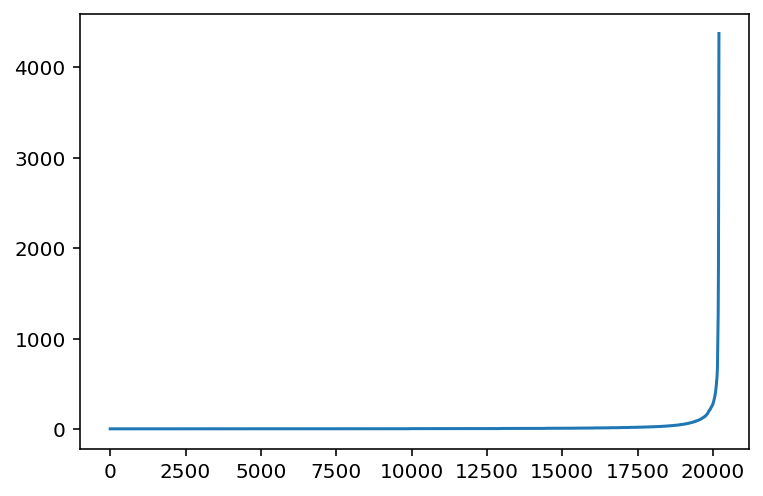

In [10]:
from collections import Counter
plt.plot(sorted(Counter(cleaned_chord_data).values()))

### ^ *Our data barely has any examples for most of the chords*
*Let's drop some notes and hope no-one notices shhhhh, I think we should have atleast 200 of each chord to train something reasonable.*

In [11]:
pruned_chord_data = []
count = collections.Counter(cleaned_chord_data)

for c in cleaned_chord_data:
    if(count[c]>200):
        pruned_chord_data.append(c)

data_summary(pruned_chord_data)

Total number of chords in data: 176898
Unique types of chords in data: 327
Count of most common chord: 4374
Number of chords that only occur once: 0
5 random samples from dataset [('G3.B4', 0.3), ('G4.E5.B4', 0.3), ('E5.C5.A4', 0.3), ('E5', 0.3), ('G3.C5', 0.3)]


## 🤩 *LFGGG!!! Only 327 chords and we still have alot of data. 176,898 chords to be exact.*

#### Does it still sound like music tho? Let's listen in...

In [12]:
pruned_chord_data_to_midi_sample = get_music_midi_filename_from_chords(pruned_chord_data[1000:1020])
FluidSynth().midi_to_audio(pruned_chord_data_to_midi_sample, "music.wav")

Audio("music.wav")

FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'music.wav'..


Parameter '/root/.fluidsynth/default_sound_font.sf2' not a SoundFont or MIDI file or error occurred identifying it.


In [13]:
c = list(set(pruned_chord_data))
mapping_from_id = dict(zip(range(len(c)), c))
mapping_to_id = dict(zip(c, range(len(c))))
chord_id_data = [mapping_to_id[ele] for ele in pruned_chord_data]

data_summary(chord_id_data)

Total number of chords in data: 176898
Unique types of chords in data: 327
Count of most common chord: 4374
Number of chords that only occur once: 0
5 random samples from dataset [275, 92, 308, 268, 326]


In [14]:
notes_network_input = []
notes_network_output = []
seq_len = 32
n_notes = len(mapping_from_id)

# create input sequences and the corresponding outputs
for i in range(len(chord_id_data) - seq_len):
    notes_sequence_in = chord_id_data[i:i + seq_len]
    notes_sequence_out = chord_id_data[i + seq_len]
    notes_network_input.append(notes_sequence_in)
    notes_network_output.append(notes_sequence_out)

n_patterns = len(notes_network_input)

# reshape the input into a format compatible with LSTM layers
network_input = np.reshape(notes_network_input, (n_patterns, seq_len, 1))/n_notes

network_output = keras.utils.np_utils.to_categorical(notes_network_output, num_classes=n_notes)

print("Input shape", network_input.shape)
print("Output shape", network_output.shape)

Input shape (176866, 32, 1)
Output shape (176866, 327)


In [15]:
from keras import Sequential
from tensorflow.keras.optimizers import Adamax
def create_network(X, y):
    #Initialising the Model
    model = Sequential()
    #Adding layers
    model.add(LSTM(512, input_shape=(32, 1), return_sequences=True))
    model.add(Dropout(0.1))
    model.add(LSTM(256))
    model.add(Dense(256))
    model.add(Dropout(0.1))
    model.add(Dense(y.shape[1], activation='softmax'))
    #Compiling the model for training  
    opt = Adamax(learning_rate=0.01)
    model.compile(loss='categorical_crossentropy', optimizer=opt)
    return model

In [16]:
model = create_network(network_input, network_output)

2022-12-02 17:38:54.370297: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-12-02 17:38:54.491240: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-12-02 17:38:54.492042: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-12-02 17:38:54.493799: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

In [17]:
model.fit(network_input, network_output, batch_size=256, epochs=200)

2022-12-02 17:38:58.732563: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/200


2022-12-02 17:39:01.991807: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


691/691 [==============================] - 21s 24ms/step - loss: 5.4194
Epoch 2/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3995
Epoch 3/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3976
Epoch 4/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3967
Epoch 5/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3960
Epoch 6/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3956
Epoch 7/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3951
Epoch 8/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3936
Epoch 9/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3928
Epoch 10/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3684
Epoch 11/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3297
Epoch 12/200
691/691 [==============================] - 17s 24ms/step - loss: 5.3036
E

## 🥳 *Finally we trained our model!!!! Time to generate a random song using our LSTM*

In [18]:
generated_music_id = chord_id_data[:32]
n_notes = len(mapping_from_id)

for i in range(100):
    model_input = generated_music_id[-32:]
    
    model_input = np.reshape(model_input, (1,32,1))/n_notes
    
    model_output = model.predict(model_input)
    model_output = model_output.argmax(axis=-1)[0]
    
    generated_music_id.append(model_output)
    
generated_music_id = generated_music_id[32:] # remove the random part of the song
print(generated_music_id)

[43, 78, 43, 310, 88, 88, 43, 299, 299, 158, 139, 65, 65, 172, 172, 164, 298, 1, 298, 1, 50, 1, 310, 66, 182, 161, 79, 290, 269, 182, 182, 50, 1, 298, 1, 298, 1, 298, 1, 50, 1, 310, 66, 182, 161, 79, 290, 269, 182, 182, 50, 1, 203, 203, 203, 203, 296, 16, 50, 1, 50, 92, 213, 107, 8, 8, 8, 8, 308, 305, 305, 255, 14, 258, 256, 308, 14, 286, 65, 14, 103, 142, 103, 142, 103, 255, 302, 299, 43, 299, 299, 115, 310, 310, 88, 88, 43, 299, 299, 123]


In [19]:
generated_music = [mapping_from_id[ele] for ele in generated_music_id]
print("Generated music:", generated_music)

Generated music: [('C5.A4', 1.25), ('G4.E3.B4', 1.25), ('C5.A4', 1.25), ('F4.A4', 0.3), ('G4.E4', 1.25), ('G4.E4', 1.25), ('C5.A4', 1.25), ('C5.A4', 0.3), ('C5.A4', 0.3), ('F4.D5.B4', 1.25), ('G4.E5.C5', 1.25), ('G4.E5.B4', 1.25), ('G4.E5.B4', 1.25), ('G3.E4.B3', 0.3), ('G3.E4.B3', 0.3), ('G3.E4.B3', 1.25), ('G4.E5', 0.3), ('F4.D5.A4', 0.3), ('G4.E5', 0.3), ('F4.D5.A4', 0.3), ('G4.E4.B4', 0.3), ('F4.D5.A4', 0.3), ('F4.A4', 0.3), ('F4.A5', 0.3), ('E4.C4.A4', 0.3), ('G4.E4.C4', 0.3), ('G5.E4.C4', 0.3), ('E4.B4', 0.3), ('E4.B5', 0.3), ('E4.C4.A4', 0.3), ('E4.C4.A4', 0.3), ('G4.E4.B4', 0.3), ('F4.D5.A4', 0.3), ('G4.E5', 0.3), ('F4.D5.A4', 0.3), ('G4.E5', 0.3), ('F4.D5.A4', 0.3), ('G4.E5', 0.3), ('F4.D5.A4', 0.3), ('G4.E4.B4', 0.3), ('F4.D5.A4', 0.3), ('F4.A4', 0.3), ('F4.A5', 0.3), ('E4.C4.A4', 0.3), ('G4.E4.C4', 0.3), ('G5.E4.C4', 0.3), ('E4.B4', 0.3), ('E4.B5', 0.3), ('E4.C4.A4', 0.3), ('E4.C4.A4', 0.3), ('G4.E4.B4', 0.3), ('F4.D5.A4', 0.3), ('E5.C5.A4', 0.3), ('E5.C5.A4', 0.3), ('E5.C5.

In [20]:
generated_music_to_midi = get_music_midi_filename_from_chords(generated_music)
FluidSynth().midi_to_audio(generated_music_to_midi, "music.wav")

print("\n\nThe music we created using our AI 🎉🎵 \n")
Audio("music.wav")

Parameter '/root/.fluidsynth/default_sound_font.sf2' not a SoundFont or MIDI file or error occurred identifying it.


FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'music.wav'..


The music we created using our AI 🎉🎵 



In [21]:
from pedalboard import Pedalboard, Chorus, Reverb
from pedalboard.io import AudioFile

# Read in a whole audio file:
with AudioFile('music.wav') as f:
  audio = f.read(f.frames)
  samplerate = f.samplerate

# Make a Pedalboard object, containing multiple plugins:
board = Pedalboard([Reverb(room_size=0.6)])

# Run the audio through this pedalboard!
effected = board(audio, samplerate)

# Write the audio back as a wav file:
with AudioFile('processed-music.wav', 'w', samplerate, effected.shape[0]) as f:
  f.write(effected)

In [22]:
print("\n\nMusic after some reverb 🥵🌶️ \n")
Audio("processed-music.wav")



Music after some reverb 🥵🌶️ 

